In [1]:
import missingno as msno
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt 
import datetime
import seaborn as sns; sns.set()
%matplotlib inline

# Reading in and formatting the data.

In [2]:
iwar = pd.read_csv('iwar_table3.csv')
orphans = pd.read_csv('orphans_table2.csv')
operators = pd.read_csv('operators_table2.csv')
parse_dates = ['shutin_dt', 'compliance_due_date', 'orig_completion', 'ice_inspection_date']
df = pd.read_csv('orphanwells_join_iwar5.csv', dtype={'og_code': str, 'operator_name': str, 'operator_no': str, 'lease_name': str, 'lease_no': str, 'well_no': str, 'api': str, 'district': str, 'county': str, 'field_name': str, 'field_no': str, 'oil_unit_no': str, 'water_land_code': str, 'api_depth': 'Int64', 'shutin_dt': str, 'well_plugged': str, 'cost_calc': 'Int64', 'compliance_due_date': str, 'orig_completion': str, 'ice_inspection_date': str, 'ice_inspection_id': str, 'sfp_code': str, 'ofcu_well_priority': str, 'sb639_enf': str, 'sb639_r15': str, 'months_delinquent': 'Int64', 'p5_renewal_month': 'Int64', 'p5_renewal_year': 'Int64', 'p5_originating_status': str, 'current_5yr_inactive': str, 'current_10yr_inactive': str, 'aged_5yr_inactive': str, 'aged_10yr_inactive': str, 'current_inactive_yrs': 'Int64', 'current_inactive_months': 'Int64', 'aged_inactive_yrs': 'Int64', 'aged_inactive_months': 'Int64', 'extension_status': str, 'ext_data_h': str, 'ext_data_e': str, 'ext_data_p': str, 'ext_data_f': str, 'ext_data_v': str, 'ext_data_x': str, 'ext_data_o': str, 'ext_data_t': str, 'ext_data_m': str, 'ext_data_k': str, 'ext_data_r': str, 'ext_data_q': str, 'ext_data_s': str, 'ext_data_w': str}, parse_dates=parse_dates)
oil_prices = pd.read_csv('oil_prices_table.csv')
oil_prices['date'] = pd.to_datetime(oil_prices['date'])
gas_prices = pd.read_csv('gas_prices_table.csv')
gas_prices['date'] = pd.to_datetime(gas_prices['date'])
gas_prices = gas_prices.sort_values(by=['date'])

### Convert columns to booleans where appropriate.

In [3]:
convert = {'t': True, 'f': False}
bool_columns = ['well_plugged', 'current_5yr_inactive', 'current_10yr_inactive', 'aged_5yr_inactive', 'aged_10yr_inactive']
for col in df.columns:
    if 'ext_data' in col or col in bool_columns:
        df[col] = df[col].map(convert)

# Oil wells are labeled with True (1), gas wells are labeled with False (0)
df['og_code'] = df['og_code'].replace({'O': True, 'G': False})

### Remove data from 1998 (all shut-in dates older than 1998 were assigned to the same year, not good for data analysis) as well as 1984 (probably the same reasoning).

In [4]:
indexes = []
for i, row in df.iterrows():
    if (datetime.datetime.fromisoformat(str(row['shutin_dt'])).strftime('%Y') == '1998') or (datetime.datetime.fromisoformat(str(row['orig_completion'])).strftime('%m/%d/%Y') == '01/12/1984'):
        indexes.append(i)

In [5]:
df = df.drop(indexes)
df.reset_index(inplace=True)
df = df.drop('index', axis=1)

### Calculate the total days active and add as a new column.

In [6]:
df['days_active'] = (df['shutin_dt'] - df['orig_completion']).dt.days

In [7]:
df

,og_code,operator_name,operator_no,lease_name,lease_no,well_no,api,district,county,field_name,...,ext_data_x,ext_data_o,ext_data_t,ext_data_m,ext_data_k,ext_data_r,ext_data_q,ext_data_s,ext_data_w,days_active
0,True,"RADIUS OPERATING, LLC",687835,"#1 RAYBURN UNIT """"A""""",13614,1,24130621,06,JASPER,"BROOKELAND (AUSTIN CHALK, 8800)",...,False,True,False,False,False,True,False,False,False,6066
1,False,"WEATHERLY OIL & GAS, LLC",902815,ADAMS GAS UNIT,173357,1,34731661,06,NACOGDOCHES,NACONICHE CREEK (ROD.-TP CONS.),...,False,False,False,False,False,False,False,False,False,7487
2,False,"WEATHERLY OIL & GAS, LLC",902815,ADAMS GAS UNIT,179816,2,34731665,06,NACOGDOCHES,NACONICHE CREEK (ROD.-TP CONS.),...,False,False,False,False,False,False,False,False,False,6998
3,False,"WEATHERLY OIL & GAS, LLC",902815,ADAMS GAS UNIT,183031,4,34731701,06,NACOGDOCHES,NACONICHE CREEK (ROD.-TP CONS.),...,False,False,False,False,False,False,False,False,False,6718
4,False,"WEATHERLY OIL & GAS, LLC",902815,ADAMS GAS UNIT,226405,10,34732429,06,NACOGDOCHES,NACONICHE CREEK (ROD.-TP CONS.),...,False,False,False,False,False,False,False,False,False,4644
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4758,True,"BOTASCH OPERATING, LLC",083330,ZAVALA,12726,1,50732320,01,ZAVALA,"ELAINE, N. (SAN MIGUEL SAND)",...,True,True,False,False,False,False,False,False,False,5124
4759,True,"BOTASCH OPERATING, LLC",083330,ZAVALA,12726,2,50732517,01,ZAVALA,"ELAINE, N. (SAN MIGUEL SAND)",...,False,True,False,False,False,False,False,False,False,2809
4760,True,"DEEP ROCK RESOURCES, INC.",209651,ZINGARA,26292,4,18530740,03,GRIMES,IOLA (GEORGETOWN),...,False,True,False,False,False,False,False,False,False,463
4761,False,"OAKWOOD ENERGY, INC.",617356,ZOCH,171004,1C,47937012,04,WEBB,"ALBERCAS, WEST (MIRANDO, UPPER)",...,False,True,False,False,False,False,False,False,False,1652


# Testing encoding categorical values.

### Dummy encoding the county names with pandas.

In [8]:
def encode_and_bind(original_dataframe, feature_to_encode):
    dummies = pd.get_dummies(original_dataframe[[feature_to_encode]])
    res = pd.concat([original_dataframe, dummies], axis=1)
    res = res.drop([feature_to_encode], axis=1)
    return(res)

In [9]:
dummy_df = encode_and_bind(df, 'county')

In [10]:
dummy_df

,og_code,operator_name,operator_no,lease_name,lease_no,well_no,api,district,field_name,field_no,...,county_WILLACY,county_WILLIAMSON,county_WILSON,county_WINKLER,county_WISE,county_WOOD,county_YOAKUM,county_YOUNG,county_ZAPATA,county_ZAVALA
0,True,"RADIUS OPERATING, LLC",687835,"#1 RAYBURN UNIT """"A""""",13614,1,24130621,06,"BROOKELAND (AUSTIN CHALK, 8800)",12193500,...,0,0,0,0,0,0,0,0,0,0
1,False,"WEATHERLY OIL & GAS, LLC",902815,ADAMS GAS UNIT,173357,1,34731661,06,NACONICHE CREEK (ROD.-TP CONS.),64300287,...,0,0,0,0,0,0,0,0,0,0
2,False,"WEATHERLY OIL & GAS, LLC",902815,ADAMS GAS UNIT,179816,2,34731665,06,NACONICHE CREEK (ROD.-TP CONS.),64300287,...,0,0,0,0,0,0,0,0,0,0
3,False,"WEATHERLY OIL & GAS, LLC",902815,ADAMS GAS UNIT,183031,4,34731701,06,NACONICHE CREEK (ROD.-TP CONS.),64300287,...,0,0,0,0,0,0,0,0,0,0
4,False,"WEATHERLY OIL & GAS, LLC",902815,ADAMS GAS UNIT,226405,10,34732429,06,NACONICHE CREEK (ROD.-TP CONS.),64300287,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4758,True,"BOTASCH OPERATING, LLC",083330,ZAVALA,12726,1,50732320,01,"ELAINE, N. (SAN MIGUEL SAND)",28225830,...,0,0,0,0,0,0,0,0,0,1
4759,True,"BOTASCH OPERATING, LLC",083330,ZAVALA,12726,2,50732517,01,"ELAINE, N. (SAN MIGUEL SAND)",28225830,...,0,0,0,0,0,0,0,0,0,1
4760,True,"DEEP ROCK RESOURCES, INC.",209651,ZINGARA,26292,4,18530740,03,IOLA (GEORGETOWN),44640275,...,0,0,0,0,0,0,0,0,0,0
4761,False,"OAKWOOD ENERGY, INC.",617356,ZOCH,171004,1C,47937012,04,"ALBERCAS, WEST (MIRANDO, UPPER)",1193333,...,0,0,0,0,0,0,0,0,0,0


In [11]:
dummy_df_sliced = dummy_df.loc[:, 'days_active':'county_ZAVALA']
dummy_df_sliced

,days_active,county_ANDERSON,county_ANDREWS,county_ANGELINA,county_ARANSAS,county_ARCHER,county_ATASCOSA,county_AUSTIN,county_BASTROP,county_BEE,...,county_WILLACY,county_WILLIAMSON,county_WILSON,county_WINKLER,county_WISE,county_WOOD,county_YOAKUM,county_YOUNG,county_ZAPATA,county_ZAVALA
0,6066,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,7487,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,6998,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,6718,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,4644,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4758,5124,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,1
4759,2809,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,1
4760,463,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4761,1652,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [12]:
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestRegressor
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.ensemble import BaggingRegressor
from sklearn.svm import SVR
from xgboost import XGBRegressor

X = dummy_df_sliced.drop(['days_active'], axis=1)
y = dummy_df_sliced['days_active']
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2)

In [13]:
rf = RandomForestRegressor()
rf.fit(X_train, y_train)
rf.score(X_test, y_test)

0.24406670538155073

Using only the encoded county names, the model performance isn't great.

### Label encoding for categorical values (currently using pd.factorize, may switch to sklearn's OneHotEncoder)

In [14]:
encoded_df = pd.DataFrame()

In [15]:
for col in df.columns:
    if df[col].dtype == 'object': 
        codes, uniques = pd.factorize(df[col])
        encoded_df[col] = codes
    elif df[col].dtype == bool:
        encoded_df[col] = df[col].replace({True: 1, False: 0})
    elif str(df[col].dtype) == 'Int64' or df[col].dtype == np.int64:
        encoded_df[col] = df[col]
    else: # for datetimes - change datetime data to number of days from the start date in the data.
        encoded_df[col] = (df[col] - df[col].min()) / np.timedelta64(1, 'D')

In [16]:
encoded_df

,og_code,operator_name,operator_no,lease_name,lease_no,well_no,api,district,county,field_name,...,ext_data_x,ext_data_o,ext_data_t,ext_data_m,ext_data_k,ext_data_r,ext_data_q,ext_data_s,ext_data_w,days_active
0,1,0,0,0,0,0,0,0,0,0,...,0,1,0,0,0,1,0,0,0,6066
1,0,1,1,1,1,0,1,0,1,1,...,0,0,0,0,0,0,0,0,0,7487
2,0,1,1,1,2,1,2,0,1,1,...,0,0,0,0,0,0,0,0,0,6998
3,0,1,1,1,3,2,3,0,1,1,...,0,0,0,0,0,0,0,0,0,6718
4,0,1,1,1,4,3,4,0,1,1,...,0,0,0,0,0,0,0,0,0,4644
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4758,1,11,11,2349,3026,0,4757,3,16,1405,...,1,1,0,0,0,0,0,0,0,5124
4759,1,11,11,2349,3026,1,4758,3,16,1405,...,0,1,0,0,0,0,0,0,0,2809
4760,1,340,340,2350,3027,2,4759,1,50,892,...,0,1,0,0,0,0,0,0,0,463
4761,0,634,634,2351,3028,269,4760,2,41,1406,...,0,1,0,0,0,0,0,0,0,1652


Code to find similarity between categorical values using jellyfish.

In [17]:
# import jellyfish as jf 
# leases = data['lease_name'].unique()

# for i in range(0, len(leases)):
#     for j in range(i + 1, len(leases)):
#         dist = jf.jaro_winkler_similarity(leases[i], leases[j])
#         if dist > 0.9:
#             print(leases[i] + ', ' + leases[j] + ', distance ' + str(dist))

# Testing supervised models (decision trees)

In [18]:
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestRegressor
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.ensemble import BaggingRegressor
from sklearn.svm import SVR
from xgboost import XGBRegressor

X = encoded_df[['og_code', 'operator_name', 'operator_no', 'lease_name', 'lease_no', 'well_no', 'api', 'district', 'county', 'field_name', 'field_no']]
y = encoded_df['days_active']
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2)

In [19]:
xgb = XGBRegressor()
xgb.fit(X_train, y_train)
xgb.score(X_test, y_test)

0.5039803694965437

In [20]:
rf = RandomForestRegressor()
rf.fit(X_train, y_train)
rf.score(X_test, y_test)

0.5149886142591942

In [21]:
gb = GradientBoostingRegressor()
gb.fit(X_train, y_train)
gb.score(X_test, y_test)

0.3807421122745691

In [22]:
bag = BaggingRegressor()
bag.fit(X_train, y_train)
bag.score(X_test, y_test)

0.46835331199599417

Text(0.5, 1.0, 'Feature Importance (MDI)')

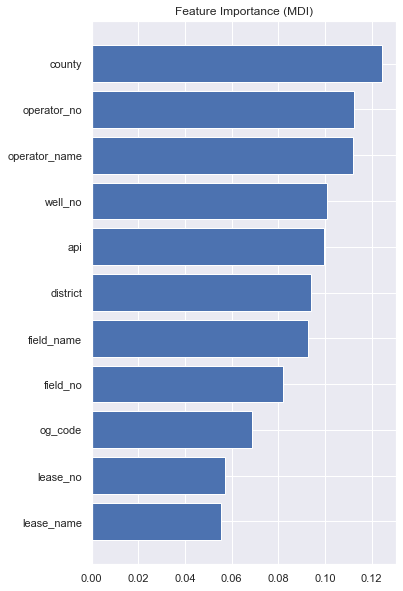

In [23]:
feature_importance = rf.feature_importances_
sorted_idx = np.argsort(feature_importance)
pos = np.arange(sorted_idx.shape[0]) + .5
fig = plt.figure(figsize=(12, 10))
plt.subplot(1, 2, 1)
plt.barh(pos, feature_importance[sorted_idx], align='center')
plt.yticks(pos, np.array(X.columns)[sorted_idx])
plt.title('Feature Importance (MDI)')

# Exploratory Data Analysis

Correlation matrix with label encoded values.

<AxesSubplot:>

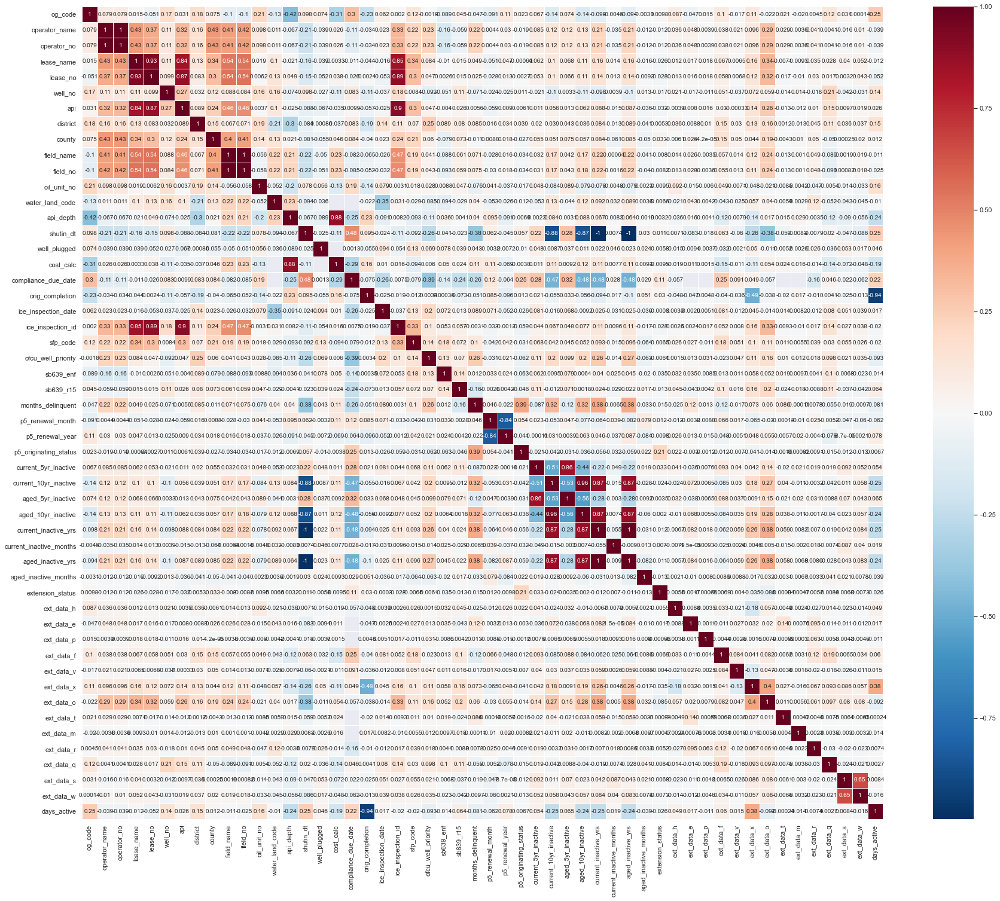

In [24]:
correlation = encoded_df.corr(method='pearson')
plt.figure(figsize=(30, 25))
sns.heatmap(correlation, 
            xticklabels=correlation.columns,
            yticklabels=correlation.columns,
            cmap='RdBu_r',
            annot=True,
            linewidth=0.5)

Correlation between shut-in date and days that the well was active.

Text(0, 0.5, 'Days Active')

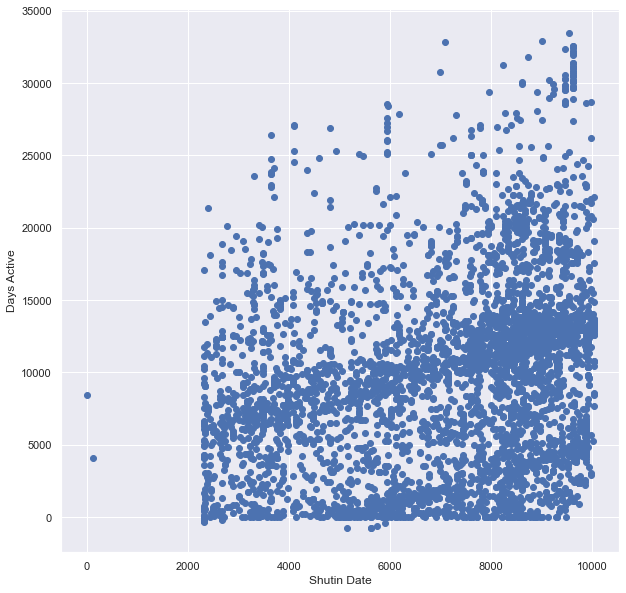

In [25]:
plt.figure(figsize=(10, 10))
plt.scatter(encoded_df['shutin_dt'], encoded_df['days_active']) #c=encoded_df['ext_data_x'])
plt.xlabel('Shutin Date')
plt.ylabel('Days Active')

Correlation between original completions and shut-in date.

Text(0, 0.5, 'Shutin Date')

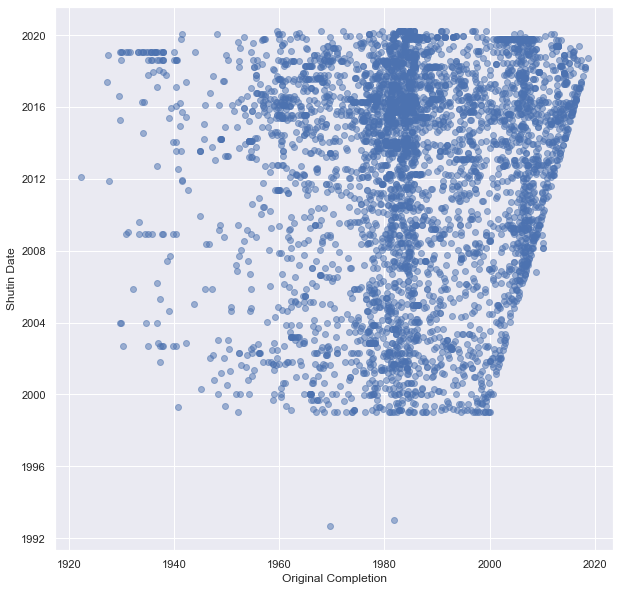

In [26]:
plt.figure(figsize=(10, 10))
plt.scatter(df['orig_completion'], df['shutin_dt'], alpha=0.5)
plt.xlabel('Original Completion')
plt.ylabel('Shutin Date')

Combining time series data (oil and gas prices).

Text(0, 0.5, 'Henry Hub Natural Gas Spot Price ($)')

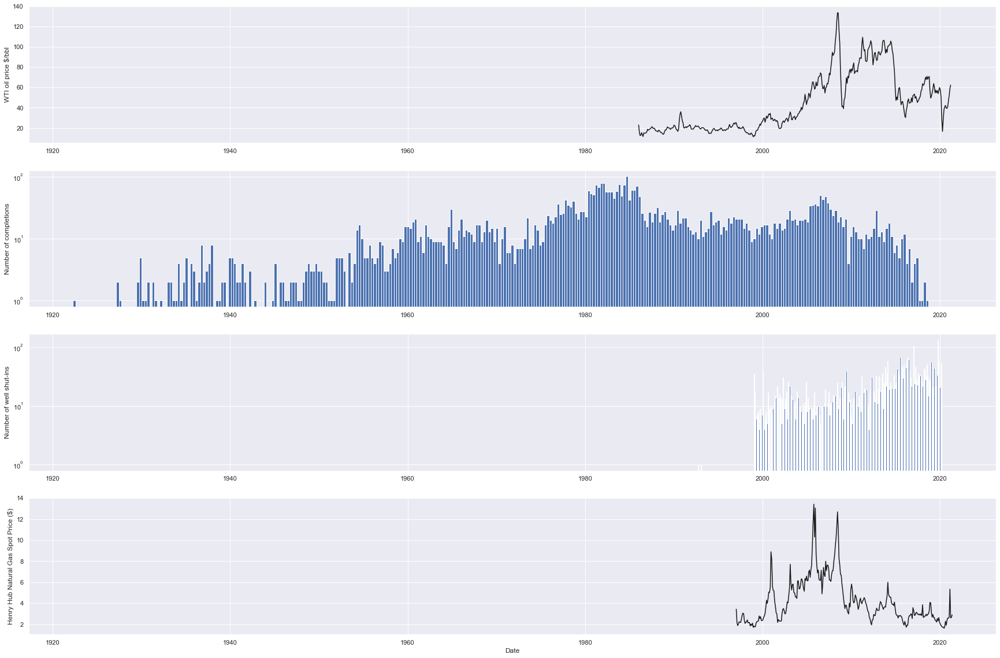

In [27]:
plt.figure(figsize=(30,20))
ax1 = plt.subplot(411)
plt.plot(oil_prices['date'], oil_prices['price'], c='k')
ax1.set_ylabel('WTI oil price $/bbl')

ax2 = plt.subplot(412, sharex=ax1)
plt.hist(df['orig_completion'], bins=336)
ax2.set_ylabel('Number of completions')
ax2.set_yscale('log')

ax3 = plt.subplot(413, sharex=ax1)
plt.hist(df['shutin_dt'], bins=336, color='b')
ax3.set_ylabel('Number of well shut-ins')
ax3.set_yscale('log')

ax4 = plt.subplot(414, sharex=ax1)
plt.plot(gas_prices['date'], gas_prices['price'], c='k')
ax4.set_xlabel('Date')
ax4.set_ylabel('Henry Hub Natural Gas Spot Price ($)')

Trying to see which operator names have the highest days active.

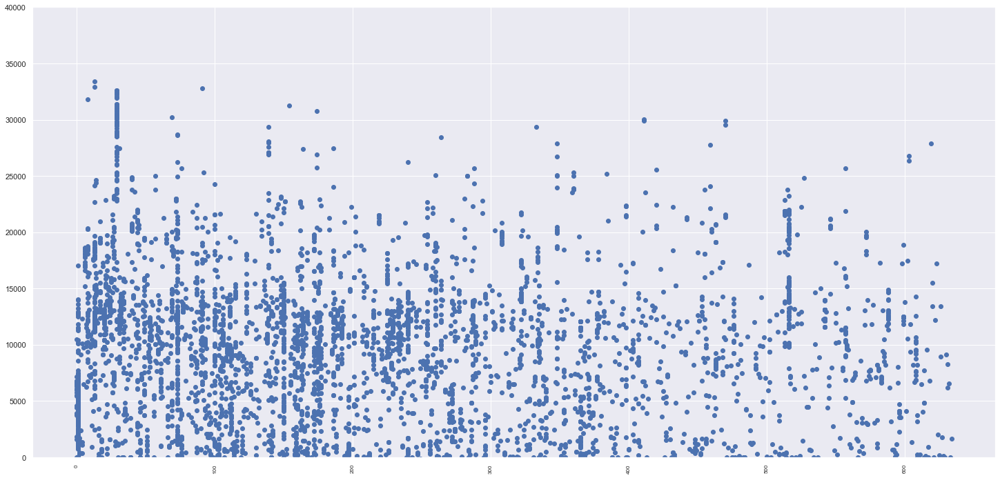

In [28]:
X = encoded_df['operator_name']
y = encoded_df['days_active'] 
plt.figure(figsize=(25, 12))
plt.scatter(X, y)
plt.ylim(0, 40_000)
plt.xticks(rotation=90, fontsize=8)
plt.show()

# Trying Clustering with numeric data.

Drop the rows with null values for well depth (potential for future imputation).

In [29]:
df_depth = df[df['api_depth'].notna()]

In [30]:
df_depth['og_code'] = df_depth['og_code'].replace({True: 1, False: 0})

<ipython-input-30-607d2350e3ea>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_depth['og_code'] = df_depth['og_code'].replace({True: 1, False: 0})


In [31]:
df_depth

,og_code,operator_name,operator_no,lease_name,lease_no,well_no,api,district,county,field_name,...,ext_data_x,ext_data_o,ext_data_t,ext_data_m,ext_data_k,ext_data_r,ext_data_q,ext_data_s,ext_data_w,days_active
0,1,"RADIUS OPERATING, LLC",687835,"#1 RAYBURN UNIT """"A""""",13614,1,24130621,06,JASPER,"BROOKELAND (AUSTIN CHALK, 8800)",...,False,True,False,False,False,True,False,False,False,6066
1,0,"WEATHERLY OIL & GAS, LLC",902815,ADAMS GAS UNIT,173357,1,34731661,06,NACOGDOCHES,NACONICHE CREEK (ROD.-TP CONS.),...,False,False,False,False,False,False,False,False,False,7487
2,0,"WEATHERLY OIL & GAS, LLC",902815,ADAMS GAS UNIT,179816,2,34731665,06,NACOGDOCHES,NACONICHE CREEK (ROD.-TP CONS.),...,False,False,False,False,False,False,False,False,False,6998
3,0,"WEATHERLY OIL & GAS, LLC",902815,ADAMS GAS UNIT,183031,4,34731701,06,NACOGDOCHES,NACONICHE CREEK (ROD.-TP CONS.),...,False,False,False,False,False,False,False,False,False,6718
4,0,"WEATHERLY OIL & GAS, LLC",902815,ADAMS GAS UNIT,226405,10,34732429,06,NACOGDOCHES,NACONICHE CREEK (ROD.-TP CONS.),...,False,False,False,False,False,False,False,False,False,4644
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4758,1,"BOTASCH OPERATING, LLC",083330,ZAVALA,12726,1,50732320,01,ZAVALA,"ELAINE, N. (SAN MIGUEL SAND)",...,True,True,False,False,False,False,False,False,False,5124
4759,1,"BOTASCH OPERATING, LLC",083330,ZAVALA,12726,2,50732517,01,ZAVALA,"ELAINE, N. (SAN MIGUEL SAND)",...,False,True,False,False,False,False,False,False,False,2809
4760,1,"DEEP ROCK RESOURCES, INC.",209651,ZINGARA,26292,4,18530740,03,GRIMES,IOLA (GEORGETOWN),...,False,True,False,False,False,False,False,False,False,463
4761,0,"OAKWOOD ENERGY, INC.",617356,ZOCH,171004,1C,47937012,04,WEBB,"ALBERCAS, WEST (MIRANDO, UPPER)",...,False,True,False,False,False,False,False,False,False,1652


Plot well depth vs. days the well was active, colored by the type of well.

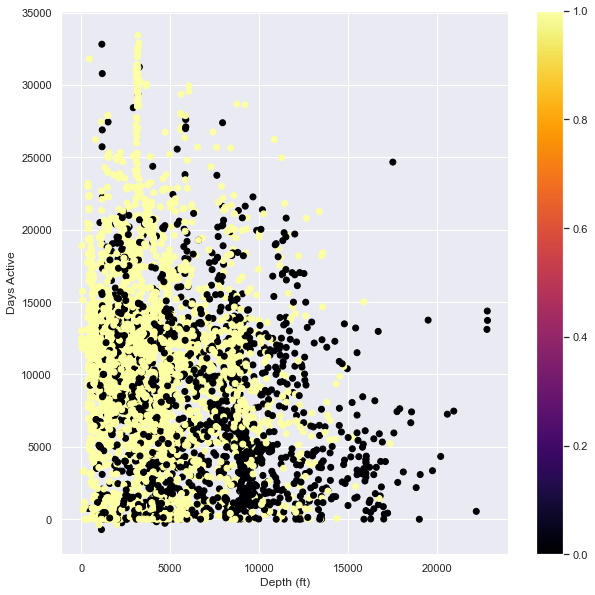

In [32]:
plt.figure(figsize=(10, 10))
plt.scatter(df_depth['api_depth'], df_depth['days_active'], c=df_depth['og_code'], cmap='inferno')
plt.xlabel('Depth (ft)')
plt.ylabel('Days Active')
plt.colorbar()

Scale the depth and days active for clustering.

In [33]:
from sklearn.preprocessing import MinMaxScaler

scaler = MinMaxScaler()
scaled_data = pd.DataFrame()
scaled_data['api_depth'] = df_depth['api_depth']
scaled_data['days_active'] = df_depth['days_active']
scaled_data = pd.DataFrame(
    scaler.fit_transform(scaled_data.values),
    columns=scaled_data.columns,
    index=scaled_data.index,
)
scaled_data

,api_depth,days_active
0,0.599421,0.198788
1,0.406761,0.240402
2,0.340334,0.226081
3,0.391415,0.217882
4,0.403560,0.157144
...,...,...
4758,0.261806,0.171201
4759,0.196606,0.103406
4760,0.419915,0.034703
4761,0.108607,0.069523


Try KMeans clustering on the data.

In [34]:
from sklearn.cluster import KMeans
from sklearn.cluster import AgglomerativeClustering
from sklearn.cluster import DBSCAN

X = scaled_data[["days_active", "api_depth"]]
cluster = KMeans(n_clusters=6, n_init=50, init="random")
cluster.fit(X)

KMeans(init='random', n_clusters=6, n_init=50)

In [35]:
X = X.assign(Label=cluster.labels_)

Text(0, 0.5, 'Days Active')

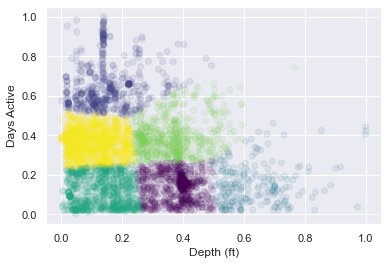

In [36]:
plt.scatter(X['api_depth'], X['days_active'], c=X['Label'], cmap="viridis", alpha=0.1)
plt.xlabel('Depth (ft)')
plt.ylabel('Days Active')

# More visualizations

Count up the # of orphan wells and the total active days of those wells in each county.

In [38]:
county_sums = {}
county_count = {}

for i, row in df.iterrows():
    curr = row['county']
    if curr in county_sums:
        county_sums[curr] += row['days_active']
        county_count[curr] += 1
    else:
        county_sums[curr] = row['days_active']
        county_count[curr] = 1

Calculate average active days of the wells in each county.

In [39]:
county_avgs = {}
for c in county_sums.keys():
    county_avgs[c] = float(county_sums[c]) / float(county_count[c])

Read in geographical county data.

In [40]:
import geopandas as gpd
counties = gpd.read_file('countydata/County.shp')
counties['CNTY_NM'] = counties['CNTY_NM'].str.upper()
counties

,FID,CMPTRL_CNT,CNTY_NM,DPS_CNTY_N,FIPS_ST_CN,TXDOT_CNTY,TXDOT_DIST,GID,SHAPE_Leng,SHAPE_Area,geometry
0,1,232,UVALDE,232,48463,232,15,35,2.475515,0.376522,"POLYGON ((-99.50031 29.08711, -99.50147 29.087..."
1,2,143,LAVACA,143,48285,143,13,36,1.927352,0.233741,"POLYGON ((-96.86553 29.63014, -96.86540 29.630..."
2,3,20,BRAZORIA,20,48039,20,12,37,3.042529,0.357074,"POLYGON ((-95.28413 29.59773, -95.28403 29.597..."
3,4,241,WHARTON,241,48481,241,13,38,2.467354,0.263143,"POLYGON ((-96.17527 29.63380, -96.17501 29.633..."
4,5,163,MEDINA,163,48325,163,15,39,2.497139,0.322366,"POLYGON ((-99.41315 29.17354, -99.41315 29.180..."
...,...,...,...,...,...,...,...,...,...,...,...
249,250,148,LIPSCOMB,148,48295,148,4,249,1.979806,0.242396,"POLYGON ((-100.50025 36.49987, -100.49461 36.4..."
250,251,179,OCHILTREE,179,48357,179,4,250,1.967322,0.238827,"POLYGON ((-100.87047 36.49997, -100.86107 36.4..."
251,252,98,HANSFORD,98,48195,99,4,251,1.965479,0.239190,"POLYGON ((-101.08518 36.49987, -101.08515 36.4..."
252,253,119,JACK,119,48237,120,2,198,1.933998,0.230609,"POLYGON ((-97.91818 33.43377, -97.91818 33.433..."


Append average active days to data from shapefile.

In [41]:
avg_data = []
total_counts = []

for i in range(len(counties)):
    name = str(counties.iloc[i]['CNTY_NM'])
    if name in county_avgs:
        avg_data.append(county_avgs[name])
        total_counts.append(county_count[name])
    else:
        avg_data.append(0)
        total_counts.append(0)
counties['avg_days_active'] = avg_data
counties['well_count'] = total_counts

Plot counties colored by average active days.

Text(109.125, 0.5, 'Latitude')

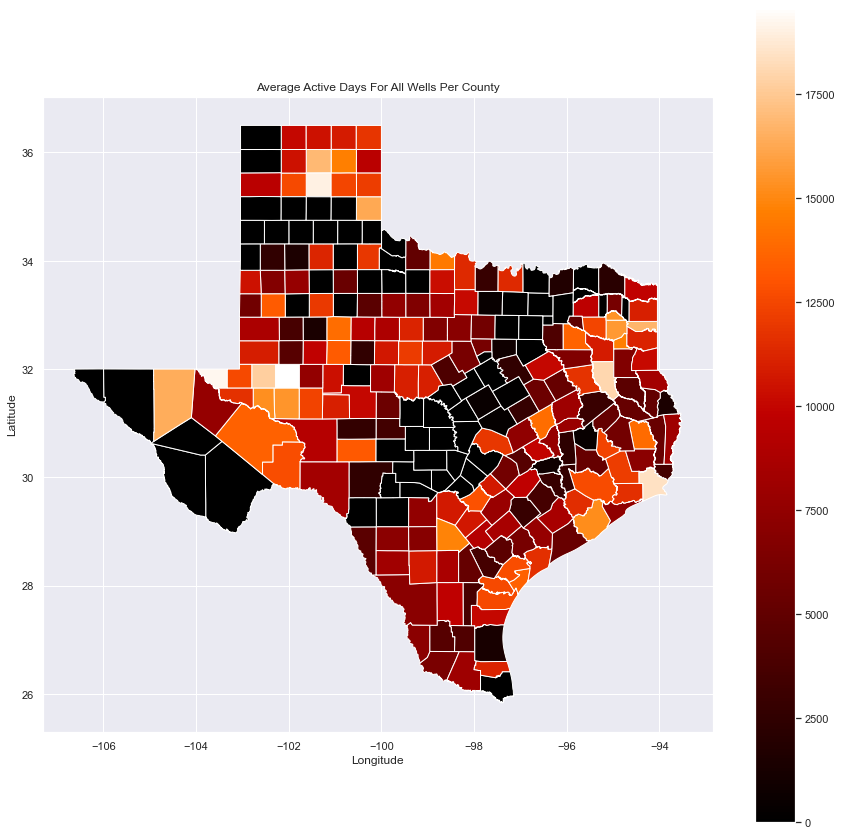

In [42]:
fig, ax = plt.subplots(figsize=(15,15))
counties.plot(column='avg_days_active', ax=ax, legend=True, cmap='gist_heat')
plt.title('Average Active Days For All Wells Per County')
plt.xlabel('Longitude')
plt.ylabel('Latitude')

Plot counties colored by orphan wells per county.

Text(109.125, 0.5, 'Latitude')

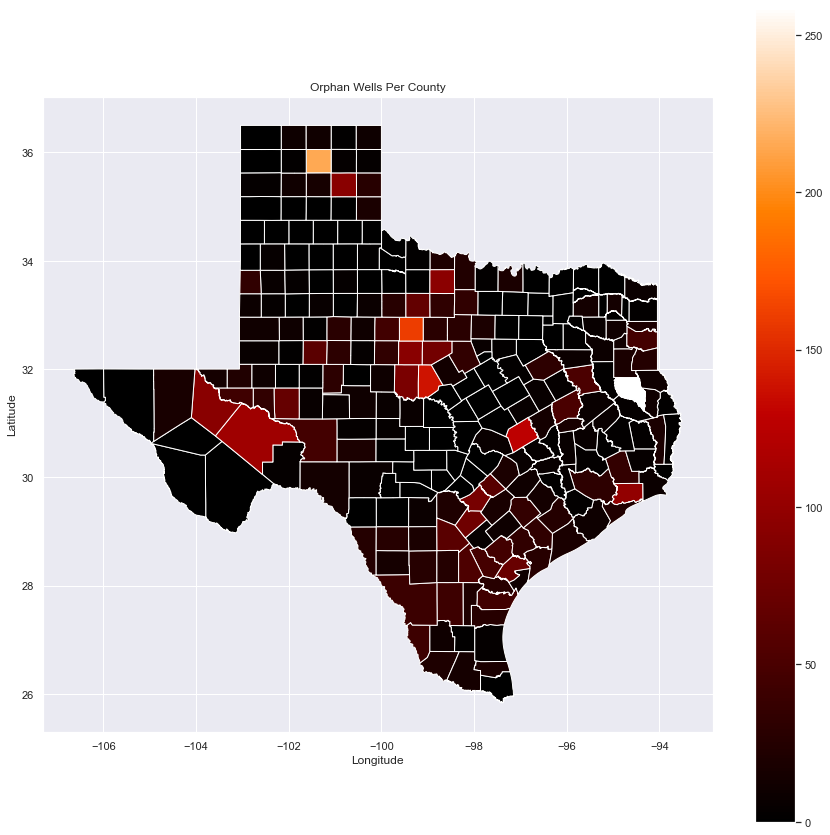

In [43]:
fig, ax = plt.subplots(figsize=(15,15))
counties.plot(column='well_count', ax=ax, legend=True, cmap='gist_heat')
plt.title('Orphan Wells Per County')
plt.xlabel('Longitude')
plt.ylabel('Latitude')

Use missingno to see which columns contain null values.

In [44]:
import missingno as msno

<AxesSubplot:>

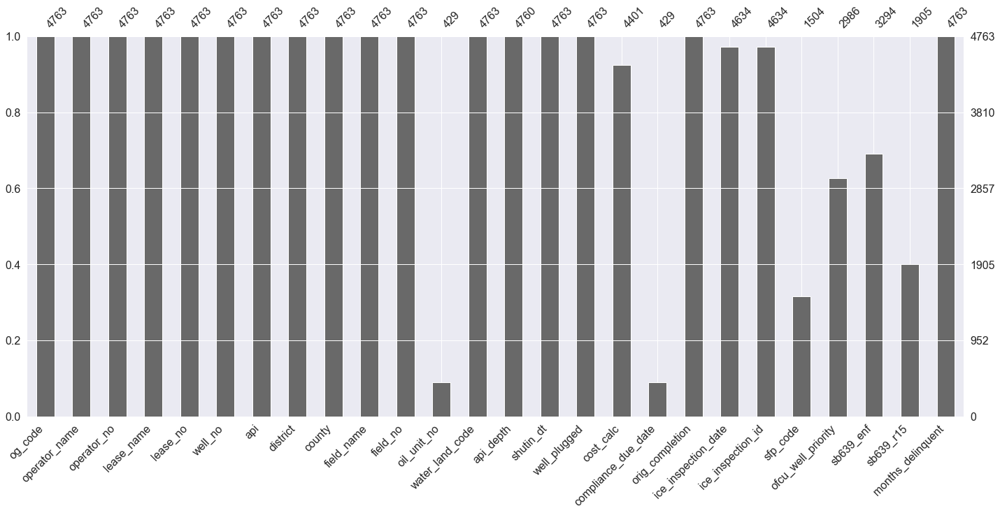

In [45]:
msno.bar(df.iloc[:, 0:26])

<AxesSubplot:>

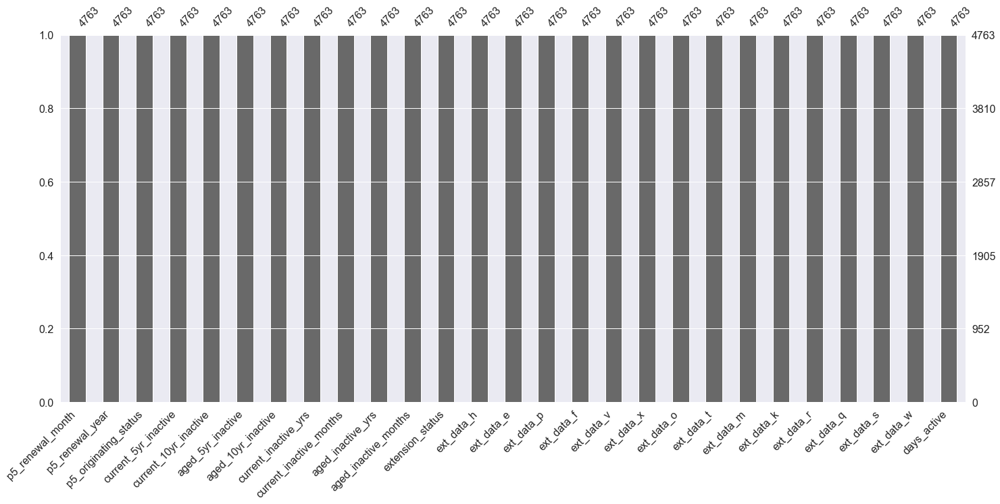

In [46]:
msno.bar(df.iloc[:, 26:])

Drop columns containing null values from the dataset.

In [47]:
df_no_nulls = df.drop(['oil_unit_no', 'cost_calc', 'compliance_due_date', 'sfp_code', 'ofcu_well_priority', 'sb639_enf', 'sb639_r15'], axis=1)
df_no_nulls

,og_code,operator_name,operator_no,lease_name,lease_no,well_no,api,district,county,field_name,...,ext_data_x,ext_data_o,ext_data_t,ext_data_m,ext_data_k,ext_data_r,ext_data_q,ext_data_s,ext_data_w,days_active
0,True,"RADIUS OPERATING, LLC",687835,"#1 RAYBURN UNIT """"A""""",13614,1,24130621,06,JASPER,"BROOKELAND (AUSTIN CHALK, 8800)",...,False,True,False,False,False,True,False,False,False,6066
1,False,"WEATHERLY OIL & GAS, LLC",902815,ADAMS GAS UNIT,173357,1,34731661,06,NACOGDOCHES,NACONICHE CREEK (ROD.-TP CONS.),...,False,False,False,False,False,False,False,False,False,7487
2,False,"WEATHERLY OIL & GAS, LLC",902815,ADAMS GAS UNIT,179816,2,34731665,06,NACOGDOCHES,NACONICHE CREEK (ROD.-TP CONS.),...,False,False,False,False,False,False,False,False,False,6998
3,False,"WEATHERLY OIL & GAS, LLC",902815,ADAMS GAS UNIT,183031,4,34731701,06,NACOGDOCHES,NACONICHE CREEK (ROD.-TP CONS.),...,False,False,False,False,False,False,False,False,False,6718
4,False,"WEATHERLY OIL & GAS, LLC",902815,ADAMS GAS UNIT,226405,10,34732429,06,NACOGDOCHES,NACONICHE CREEK (ROD.-TP CONS.),...,False,False,False,False,False,False,False,False,False,4644
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4758,True,"BOTASCH OPERATING, LLC",083330,ZAVALA,12726,1,50732320,01,ZAVALA,"ELAINE, N. (SAN MIGUEL SAND)",...,True,True,False,False,False,False,False,False,False,5124
4759,True,"BOTASCH OPERATING, LLC",083330,ZAVALA,12726,2,50732517,01,ZAVALA,"ELAINE, N. (SAN MIGUEL SAND)",...,False,True,False,False,False,False,False,False,False,2809
4760,True,"DEEP ROCK RESOURCES, INC.",209651,ZINGARA,26292,4,18530740,03,GRIMES,IOLA (GEORGETOWN),...,False,True,False,False,False,False,False,False,False,463
4761,False,"OAKWOOD ENERGY, INC.",617356,ZOCH,171004,1C,47937012,04,WEBB,"ALBERCAS, WEST (MIRANDO, UPPER)",...,False,True,False,False,False,False,False,False,False,1652


Use dummy encoding for operator number and field name categorical variables.

In [48]:
features_to_encode = ['operator_no', 'field_name']

for feature in features_to_encode:
    df_no_nulls = encode_and_bind(df_no_nulls, feature)

In [49]:
X = df_no_nulls.iloc[:, 44:].copy()
y = df_no_nulls['days_active']

Train decision tree regressor.

In [50]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3)

xgb = XGBRegressor()
xgb.fit(X_train, y_train)
xgb.score(X_test, y_test)

0.4668559295571305

Possible classification problem: determining whether a well is oil/gas based on the depth? Not sure if useful, but could be interesting. (working on more visuals)

In [51]:
from sklearn.ensemble import GradientBoostingClassifier

X = pd.DataFrame()
X['api_depth'] = df_no_nulls['api_depth']
X['og_code'] = df_no_nulls['og_code']
X = X.dropna()
y = X['og_code']
X = X.drop(['og_code'], axis=1)

In [52]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3)

gbc = GradientBoostingClassifier()
gbc.fit(X_train, y_train)
gbc.score(X_test, y_test)

0.7359943977591037